In [2]:
import numpy as np
import pandas as pd
import os
from shutil import copyfile
import pickle
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import colorlover as cl


import neuro_morpho_toolbox as nmt
%matplotlib inline
import pickle
pickle_in = open("/home/penglab/FeaCal/all_ns.pickle","rb")
[ns] = pickle.load(pickle_in)


/home/penglab/anaconda3/lib/python3.7/site-packages/neuro_morpho_toolbox-0.1-py3.7.egg/neuro_morpho_toolbox/
Loading CCF Atlas data...
Loading time: 1.01
Loading CCF brain structure data...
Loading time: 0.00


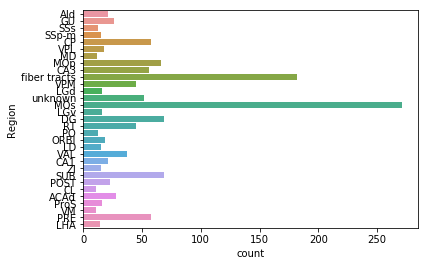

In [4]:
sf = ns.features['soma_features'].region
ct = sf["Region"].value_counts().sort_values(ascending=False)
_ = sns.countplot(y="Region", 
                  data=sf.loc[sf.Region.isin(ct.index[ct>10])],
                 )

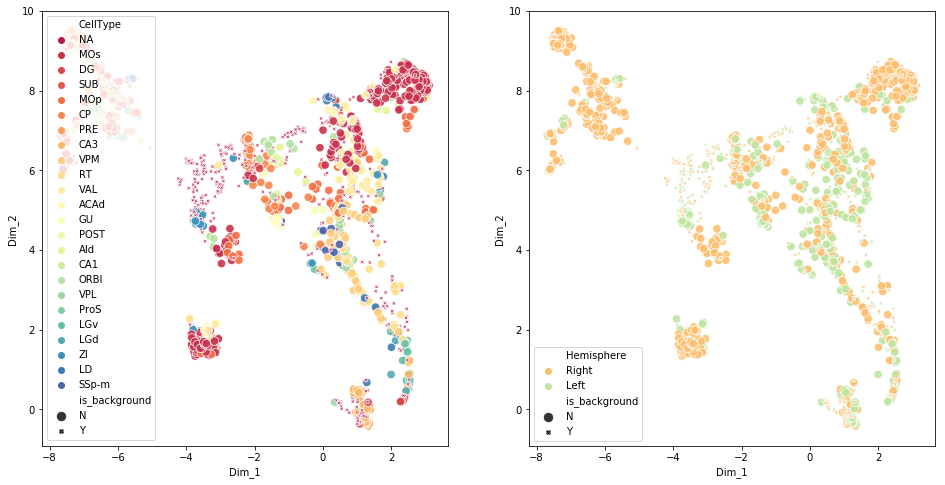

In [5]:
_ = ns.ReduceDimUMAP(feature_set="projection_features", n_neighbors=100)
_ = ns.FeatureScatter(["CellType", "Hemisphere"], map="UMAP")

In pd.groupby()
* The result can be stored using list()
* Length of the list is the number of groups
* For each element in the list
    * The first item is the value of that group
    * The second item is a dataframe storing all the related rows

In [83]:
from sklearn import metrics
from random import randrange
def pickCLUSTERpara(method):
    result_DF = pd.DataFrame()
    method_list = ['kmeans','snn','hdbscan','hierarchy','dbscan']
    assert method in method_list, "Should be one of "+str(method_list)
    colname = ['ClusterINFO','NumCluster','parameter']
    if method.lower() == 'hierarchy':
        #%% Store the result of Hierarchy
        result_hier = pd.DataFrame(columns = colname)
        L_method_list=['single', 'complete','average','weighted','centroid','median','ward']
        L_metric_list=['braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation', 'cosine',
                       'dice', 'euclidean', 'hamming', 'jaccard', 'kulsinski', 
                       'mahalanobis', 'matching','minkowski','rogerstanimoto', 'russellrao',
                       'seuclidean', 'sokalmichener', 'sokalsneath', 'sqeuclidean']
        #linkage using 'yule' and 'jensenshannon' may result in a condensed distance matrix must contain only finite values.

        criterionH_list=['inconsistent','distance','maxclust','monocrit','maxclust_monocrit']

        hier_dict={'L_method':'single', 'L_metric':'euclidean','criterionH':'inconsistent', 'depth':2,'R':None,'t':0.9,'optimal_ordering':False,'colR':3}
        for L_methodidx in L_method_list:
            hier_dict.update(L_method = L_methodidx)
            for L_metricidx in L_metric_list:
                hier_dict.update(L_metric = L_metricidx )
                # so far the parameter to generate the linkage array is set
                if L_methodidx == 'centroid' or L_methodidx == 'median' or L_methodidx == 'ward':
                    if L_metricidx != 'euclidean':
                        continue         
                for criterionidx in criterionH_list:
                    hier_dict.update(criterionH = criterionidx )   
                    if criterionidx == 'inconsistent' or criterionidx == 'distance':
                        for t_iter in  np.arange(0,1.6,0.05)  : 
                            hier_dict.update(t = t_iter) 
                            if criterionidx == 'inconsistent':
                                for depth_iter in range(2,16):
                                    hier_dict.update(depth = depth_iter) 
                                    _ = ns. get_clusters(method='Hierarchy',karg_dict=hier_dict)
                                    tempDF = pd.DataFrame([str(list(ns.metadata.groupby('Cluster'))), 
                                                           len(list(ns.metadata.groupby('Cluster'))),
                                                           str(hier_dict)]).T.copy()
                                    tempDF.columns=colname
                                    print(str(hier_dict))
                                    result_hier = result_hier.append(tempDF) 
                            elif criterionidx == 'distance':
                                _ = ns. get_clusters(method='Hierarchy',karg_dict=hier_dict)
                                tempDF = pd.DataFrame([str(list(ns.metadata.groupby('Cluster'))), 
                                                       len(list(ns.metadata.groupby('Cluster'))),
                                                       str(hier_dict)]).T.copy()
                                tempDF.columns=colname
                                print(str(hier_dict))
                                result_hier = result_hier.append(tempDF) 
                    if criterionidx == 'maxclust' or criterionidx == 'maxclust_monocrit':
                        for t_iter in  range(20,51): 
                            hier_dict.update(t = t_iter) 
                            _ = ns. get_clusters(method='Hierarchy',karg_dict=hier_dict)
                            tempDF = pd.DataFrame([str(list(ns.metadata.groupby('Cluster'))), 
                                                   len(list(ns.metadata.groupby('Cluster'))),
                                                   str(hier_dict)]).T.copy()
                            tempDF.columns=colname
                            print(str(hier_dict))
                            result_hier = result_hier.append(tempDF) 
                               
        idx_hier = ['Hier'+str(x) for x in range(result_hier.shape[0])]    
        result_hier['idx'] = idx_hier
        result_hier.set_index('idx',inplace=True)  
        result_DF = result_hier.copy()
        
    if method.lower() == 'kmeans':
        result_kmeans = pd.DataFrame(columns = colname)
        init_list=['k-means++','random']
        algorithm_list = ['auto','full','elkan']
        precompute_distances_list = ['auto', True, False]
        n_init_list=['braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation', 'cosine',
                       'dice', 'euclidean', 'hamming', 'jaccard', 'kulsinski', 
                       'mahalanobis', 'matching','minkowski','rogerstanimoto', 'russellrao',
                       'seuclidean', 'sokalmichener', 'sokalsneath', 'sqeuclidean']
        #linkage using 'yule' and 'jensenshannon' may result in a condensed distance matrix must contain only finite values.
        criterionH_list='inconsistent','distance','maxclust','monocrit','maxclust_monocrit'
        kmeans_dict={'n_clusters':20, 'init':'k-means++', 'n_init':10, 'max_iter':300, 'tol':0.0001,
                     'precompute_distances':'auto', 'verbose':0, 'random_state':None,'copy_x': True,
                     'n_jobs':12, 'algorithm':'auto'}
        for init_idx in init_list:
            kmeans_dict.update(init = init_idx)
            for algorithm_idx in algorithm_list:
                kmeans_dict.update(algorithm = algorithm_idx )
                for precompute_distances_idx in precompute_distances_list:
                    kmeans_dict.update(precompute_distances = precompute_distances_idx )
                    for n_clustersidx in range(3,45):
                        kmeans_dict.update(n_clusters = n_clustersidx)     
                        #Number of time the k-means algorithm will be run with different centroid seeds. The final results will be the best output of n_init consecutive runs in terms of inertia.
                        for n_initidx in range(7,15):
                            kmeans_dict.update(n_init = n_initidx) 
                            for tol_idx in np.exp(-np.arange(2,4,0.2)):
                                kmeans_dict.update(tol = tol_idx) 
                                print(kmeans_dict)
                                _ = ns. get_clusters(method='Kmeans',karg_dict=kmeans_dict)
                                tempDF = pd.DataFrame([str(list(ns.metadata.groupby('Cluster'))), len(list(ns.metadata.groupby('Cluster'))),str(kmeans_dict)]).T.copy()
                                tempDF.columns=colname
                                print(str(kmeans_dict))
                                result_kmeans = result_kmeans.append(tempDF)         
        idx_kmeans = ['KMeans'+str(x) for x in range(result_kmeans.shape[0])]    
        result_kmeans['idx'] = idx_kmeans
        result_kmeans.set_index('idx',inplace=True)       
        result_DF = result_kmeans.copy()
        
    if method.lower() == 'dbscan':
        result_dbscan = pd.DataFrame(columns = colname)
        algorithm_list = ['auto','ball_tree', 'kd_tree', 'brute']# 
         #
        metriclist = [ 'braycurtis', 'canberra', 'chebyshev', 'cityblock', 'correlation','euclidean', 'cosine',
                      'dice','hamming', 'jaccard', 'kulsinski', 'matching','minkowski','rogerstanimoto','russellrao','sokalmichener', 'sokalsneath']
        dbscan_dict={'eps':20, 'min_samples':5, 'metric':'euclidean','metric_params':None, 'algorithm':'auto', 
                     'leaf_size':30, 'p':None,'n_jobs':12}
        for algorithm_idx in algorithm_list:
            dbscan_dict.update(algorithm = algorithm_idx )
            for metric_iter in metriclist:
                dbscan_dict.update(metric= metric_iter)
                if algorithm_idx == 'ball_tree' and metric_iter in ['correlation','cosine','sqeuclidean']:
                    continue
                if algorithm_idx == 'kd_tree' and metric_iter not in ['chebyshev', 'cityblock', 'euclidean',
                                                                                   'infinity', 'l1', 'l2', 'manhattan',
                                                                                  'minkowski', 'p']:
                    continue
                if algorithm_idx == 'brute' and metric_iter in ['haversine','wminkowski', 'mahalanobis','infinity']:
                    continue
                if metric_iter in ['wminkowski', 'minkowski']:
                    p_iter =randrange(1,10)
                    dbscan_dict.update(p = p_iter)
                    while metric_iter == 'minkowski' and p_iter == 1:
                        p_iter =randrange(2,10)
                        dbscan_dict.update(p = p_iter)
                for epsidx in np.exp(-np.arange(0,4,0.5)):
                    dbscan_dict.update(eps = epsidx)
                    for min_samples_iter in range(5,10):
                        dbscan_dict.update(min_samples = min_samples_iter)
                        for leaf_size_iter in range(25,35):
                            dbscan_dict.update(leaf_size = leaf_size_iter)
                            _ = ns. get_clusters(method='DBSCAN',karg_dict=dbscan_dict)
                            tempDF = pd.DataFrame([str(list(ns.metadata.groupby('Cluster'))), len(list(ns.metadata.groupby('Cluster'))),str(dbscan_dict)]).T.copy()
                            tempDF.columns=colname
                            print(str(dbscan_dict))
                            result_dbscan = result_dbscan.append(tempDF)        
        idx_dbscan = ['DBSCAN'+str(x) for x in range(result_dbscan.shape[0])]    
        result_dbscan['idx'] = idx_dbscan
        result_dbscan.set_index('idx',inplace=True)     
        result_DF = result_dbscan.copy()
        
    if method.lower() == 'hdbscan':
        result_hdbscan = pd.DataFrame(columns = colname)
        #
        metric_list = [ 'euclidean','minkowski', 'l2', 'l1', 'manhattan', 'cityblock', 'braycurtis', 'canberra',
                       'chebyshev','correlation','dice', 'hamming', 'jaccard','kulsinski', 'matching', 
                       'rogerstanimoto', 'russellrao','sokalmichener', 'sokalsneath', 'sqeuclidean', 'yule']
        
    
        algorithm_list = ['best', 'generic','prims_kdtree','boruvka_kdtree']#, 
        cluster_selection_method_list = ['leaf','eom']
        hdbscan_dict={'min_cluster_size':5, 'metric':'euclidean','alpha':1.0, 'min_samples':1,
                      'p':2,'algorithm':'best', 'leaf_size':40, 'approx_min_span_tree':True,
                      'gen_min_span_tree':False,'core_dist_n_jobs':4,'cluster_selection_method':'eom',
                      'allow_single_cluster': False,'prediction_data':False,
                      'match_reference_implementation':False}

        for algorithm_idx in algorithm_list:
            hdbscan_dict.update(algorithm = algorithm_idx)
            for metric_idx in metric_list:
                if algorithm_idx=='boruvka_kdtree' and metric_idx in['braycurtis','canberra','dice','hamming',
                                                                     'jaccard','kulsinski','matching','rogerstanimoto',
                                                                     'russellrao','sokalmichener', 'sokalsneath']:
                    continue
                hdbscan_dict.update(metric = metric_idx)
                for cluster_selection_method_idx in cluster_selection_method_list:
                    hdbscan_dict.update(cluster_selection_method = cluster_selection_method_idx )
                    for alpha_idx in np.arange(0.8,1.5,0.1):
                        hdbscan_dict.update(alpha = alpha_idx)
                        for min_samples_iter in range(1,10):
                            hdbscan_dict.update(min_samples = min_samples_iter)
                            #print(hdbscan_dict)
                            _ = ns. get_clusters(method='HDBSCAN',karg_dict=hdbscan_dict)
                            tempDF = pd.DataFrame([str(list(ns.metadata.groupby('Cluster'))), len(list(ns.metadata.groupby('Cluster'))),str(hdbscan_dict)]).T.copy()
                            tempDF.columns = colname
                            print(str(hdbscan_dict))
                            result_hdbscan = result_hdbscan.append(tempDF)     

        idx_hdbscan = ['HDBSCAN'+str(x) for x in range(result_hdbscan.shape[0])]    
        result_hdbscan['idx'] = idx_hdbscan
        result_hdbscan.set_index('idx',inplace=True)       
        result_DF = result_hdbscan.copy()
    if method.lower() == 'snn':
        snn_dict = {'knn':5, 'metric':'minkowski','method':'FastGreedy'}
        result_snn= pd.DataFrame(columns = colname)
        _ = ns. get_clusters(method='SNN_community',
                             karg_dict={'knn':5,
                                        'metric':'minkowski',
                                        'method':'FastGreedy'})
        tempDF = pd.DataFrame([str(list(ns.metadata.groupby('Cluster'))), len(list(ns.metadata.groupby('Cluster'))),str(snn_dict)]).T.copy()
        tempDF.columns=colname
        print(str(snn_dict))
        result_snn = result_snn.append(tempDF)
        result_DF = result_snn.copy()
    return result_DF.copy()
    

In [84]:
dbscan_resultDF = pickCLUSTERpara('dbscan')
dbscan_resultDF.to_excel('/home/penglab/NMTcode/dbscan_resultDF.xlsx')

Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 

{'eps': 1.0, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'a

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'braycurtis', 'metric_p

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'braycurtis', 'met

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'braycurtis', 'met

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'braycurtis', 'metric_pa

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'braycurtis', 'metric_pa

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'braycurtis'

{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'braycurtis', 'metric_pa

{'eps': 1.0, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clusterin

{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None,

{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'canberra', 'metric_params':

{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'canberra', 'metric_params':

{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None,

{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None,

{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'canberra', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'canberra', 'metric_pa

{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None,

{'eps': 1.0, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params':

{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'chebyshev', 'metric_pa

{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'chebyshev', 'metric_pa

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params':

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'chebyshev', 'met

{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params':

{'eps': 1.0, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cityblock', 'metric_params':

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'cityblock', 'metric_param

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cityblock', 'metric_pa

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cityblock', 'metric_pa

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cityblock', 'metric_params':

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cityblock', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cityblock', 'met

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cityblock', 'metric_params':

{'eps': 1.0, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result o

{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'correlation', 'met

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'correlation'

{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'correlation'

{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'correlation', 'met

{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'correlation', 'met

{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'correlation', 'met

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'correl

{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'correlation', 'met

{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'euclidean', 'metric_params':

{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'euclidean', 'metric_pa

{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 'metric_pa

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'euclidean', 'metric_params':

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'euclidean', 'met

{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidean', 'metric_params':

{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None

{'eps': 1.0, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p'

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'cosine', 'metric_params': None, 'algorith

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algo

{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algo

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm'

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm'

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None,

{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm'

{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samp

{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'l

{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'aut

{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'aut

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'l

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'l

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm'

{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'auto', 'l

{'eps': 1.0, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'ep

{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algo

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None,

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None,

{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None,

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algo

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algo

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params':

{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algo

{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'ep

{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algo

{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None,

{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None,

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algo

{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algo

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'al

{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto

{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Resul

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params':

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_pa

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_pa

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params':

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'met

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params':

{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clusterin

{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None,

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params':

{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params':

{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None,

{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None,

{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None,

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_pa

{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': None, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None,

{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorit

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'a

{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'a

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorit

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorit

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': No

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorit

{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result o

{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', '

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimo

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimo

{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimo

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', '

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', '

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogers

{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', '

{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'ep

{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'a

{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': No

{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': No

{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'a

{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'a

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_param

{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': No

{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'a

{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSC

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', '

{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', '

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichen

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric

{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clusterin

{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': No

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_param

{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_param

{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params':

{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': No

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': No

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric

{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'auto', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': No

{'eps': 1.0, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Re

{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'braycurtis', 

{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'braycur

{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'braycur

{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'braycurtis', 

{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'braycurtis', 

{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'bra

{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'b

Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples':

{'eps': 1.0, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSC

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'canberra', 'metric_para

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'canberra', 'metri

{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'canberra', 'metri

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'canberra', 'metric_para

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'canberra', 'metric_para

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'canberra', 

{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'canberra', 'metric_para

{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result o

{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metri

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'chebyshev', 'me

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metri

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metri

Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_sa

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metri

{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result o

{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metri

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 

{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 

{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'cityblock', 'met

{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metri

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cityblock', 'metri

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'citybl

{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metri

{'eps': 1.0, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result o

{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'euclidean', 'metri

{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 

{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metri

{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metri

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclid

{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidea

{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metri

{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algori

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algori

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, '

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 

{'eps': 1.0, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'hamming', 'metric_params': N

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'hamming', 'metric_para

{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'hamming', 'metric_para

{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'hamming', 'metric_params'

{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': N

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'hamming', 'metric_params': N

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'hamming', 'metri

{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': N

{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': N

{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_para

{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_para

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': N

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': N

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metri

{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': N

{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p':

{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metri

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metri

Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, '

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsin

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metri

{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSC

{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_para

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metri

{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metri

{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_para

{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_para

{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_para

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 

{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 3, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_para

{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result o

{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metri

{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'minkowski', 

{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'minkowski', 

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'minkowski', 'metri

{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'minkowski', 'metri

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'minkow

{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'minkowski', 'met

{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params':

{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'met

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8

{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'met

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'met

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_sampl

{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'met

{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'russellr

{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Re

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russell

{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russell

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'r

{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 

{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7

{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric':

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'me

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'me

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric':

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric':

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 

{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric':

{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 

{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_p

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsne

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'so

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'so

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsne

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsne

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric

{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'ball_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsne

{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params':

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'chebyshev', 'metric_param

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_pa

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_pa

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params':

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'met

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params':

{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'cityblock', 'metric_params':

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 'metric_pa

{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'cityblock', 'metric_pa

{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'cityblock', 'metric_params

{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'cityblock', 'metric_params':

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'cityblock', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'cityblock', 'met

{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'cityblock', 'metric_params':

{'eps': 1.0, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'euclidean', 'metric_params':

{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'euclidean', 'metric_pa

{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'euclidean', 'metric_pa

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'euclidean', 'metric_params':

{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'euclidean', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'euclidean', 'met

{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'euclidean', 'metric_pa

{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params':

{'eps': 1.0, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'minkowski', 'metric_params':

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'minkowski', 'metric_pa

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_pa

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'minkowski', 'metric_params':

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'minkowski', 'metric_params':

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'minkowski', 'met

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'kd_tree', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'minkowski', 'metric_params':

{'eps': 1.0, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clusterin

Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'brayc

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params

Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 

{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params

{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': Non

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'braycurtis', 'metric_params': Non

Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'met

{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'braycurtis', 'metric_params': Non

{'eps': 1.0, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.

{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorith

Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'canberra'

{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'canberra', 'metric_params': None, 'al

{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorith

{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorith

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'canberra', 'metric_params': Non

Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'canberra', 'met

{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'ep

{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'al

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'chebyshev', 'metric_params': None, 

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': Non

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': Non

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'chebyshev', 'metric_params': None, 'al

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'al

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'chebyshev', 'metric_params

Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'chebyshev'

{'eps': 1.0, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'ep

Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'cityblock'

{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'cityblock', 'metric_params': Non

Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'city

{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'al

{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'cityblock', 'metric_params': None, 'al

{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'cityblock', 'metric_params

{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'cityblock', 'metric_params': N

{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'cityblock', 'metric_params': None, 'al

Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_job

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'correlation', 'metric_params

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'correlation', 'metric_

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'correlation', 'metric_

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'correlation', 'metric_params

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'correlation', 'metric_params

{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'correlation', 'm

{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'correlation', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'correlation', 'metric_params

{'eps': 1.0, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'ep

{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'al

{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'euclidean', 'metric_params': Non

Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'eucl

{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'euclidean', 'metric_params': None, '

{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'al

{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'al

{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'euclidean', 'metric_params

{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'euclidean', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'euclidean', 'metric_params': None, 'al

{'eps': 1.0, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samp

{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute',

{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'b

{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'b

{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute',

{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute',

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorith

{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'cosine', 'metric_params': None, 'algorithm': 'brute',

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'dice', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clu

{'eps': 1.0, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_si

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'hamming', 'metric_params': None, 'algorithm': '

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorith

Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'hamming', 'met

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'b

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'b

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'al

{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'hamming', 'metric_params': None, 'algorithm': 'b

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'jaccard', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'kulsinski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'matching', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 7, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN C

{'eps': 1.0, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brut

{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'minkowski', 'metric_params': None, '

{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': Non

{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'minkowski', 'metric_params': Non

{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'al

{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'minkowski', 'metric_params': None, 'al

{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'minkowski', 'metric_params

{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'minkowski', 'metric_params': None, 'al

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'rogerstanimoto', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'russellrao', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalmichener', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 1.0, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.6065306597126334, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.36787944117144233, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.22313016014842982, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.1353352832366127, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0820849986238988, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.049787068367863944, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 5, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 6, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 7, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 8, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 25, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 26, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 27, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 28, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 29, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 30, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 31, 'p': 9, 'n_jobs': 12}


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 32, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering
{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 33, 'p': 9, 'n_jobs': 12}
Result of DBSCAN Clustering


/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.

/home/penglab/anaconda3/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning:

Data with input dtype float32 was converted to bool by check_pairwise_arrays.



{'eps': 0.0301973834223185, 'min_samples': 9, 'metric': 'sokalsneath', 'metric_params': None, 'algorithm': 'brute', 'leaf_size': 34, 'p': 9, 'n_jobs': 12}


In [44]:
len(sorted(sklearn.neighbors.VALID_METRICS['brute']))

27

In [45]:
len(sorted(sklearn.neighbors.VALID_METRICS['kd_tree']))

9

In [42]:
import sklearn
len(sorted(sklearn.neighbors.VALID_METRICS['brute']) )

27

In [37]:
kmeans_resultDF = pickCLUSTERpara('kmeans')
kmeans_resultDF.to_excel('/home/penglab/NMTcode/kmeans_resultDF.xlsx')

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'to

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0742735782

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110803158362

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0907179

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.13533

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.06081

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110803158362

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110803158362

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110803158362

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0742735782

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.135

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.090

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.13

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300,

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'to

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300,

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300,

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 3

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300,

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 3

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter':

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 3

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter':

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter':

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 3

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter':

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, '

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 30

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, '

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300,

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, '

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300,

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 3

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, '

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300,

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 3

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 3

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter':

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 3

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, '

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300,

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300,

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 3

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, '

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter':

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 3

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter':

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 3

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 3

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300,

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300,

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 30

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 3

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300,

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300,

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 3

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter':

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 3

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter':

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 30

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 3

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 30

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter':

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, '

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 30

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter':

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, '

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 30

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300,

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, '

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300,

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 3

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 't

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300,

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 3

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 't

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter':

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 3

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 't

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter':

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 3

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0907179

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol':

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol'

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol'

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.110

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol'

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol':

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol':

{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol':

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol':

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 

{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol'

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300,

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol'

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 22, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 't

{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 't

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 't

{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300,

{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'k-means++', 'n_init': 14, 'max_iter': 30

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 't

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 34, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 35, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300

{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 

{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 

{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol':

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'to

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol':

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'to

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'to

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, '

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'to

{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol'

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'to

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, '

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'to

{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, '

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 8, 'max_iter': 300, 'tol'

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 10, 'max_iter': 300

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 12, 'max_iter': 300, '

{'n_clusters': 43, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'to

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 7, 'max_iter': 300, 'tol':

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 9, 'max_iter': 300, 'tol'

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 11, 'max_iter': 300

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'k-means++', 'n_init': 13, 'max_iter': 300, '

{'n_clusters': 44, 'init': 'k-means++', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333732699603260

Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247,

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.040

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'p

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precomp

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precom

{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precom

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precomp

{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'prec

{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precomp

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precomp

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, '

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699603

{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'p

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'pr

{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'pre

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'p

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'p

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'p

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, '

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'pre

{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'p

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617,

{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373269

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'auto'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556

{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863

{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863

{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836

{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497870683

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497870683

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0497870683

{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625

{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'pre

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'prec

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'preco

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precom

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'preco

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precomp

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'prec

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'preco

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'p

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699603

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'p

{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127

{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, '

{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'p

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617

{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, '

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447292

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, '

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604,

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367

{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924,

{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, '

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699603

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786389

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06081006262521

{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214333

{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894124

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, '

{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.022370771856165

{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032

{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617,

{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, '

{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, '

{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'pr

{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617,

{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, '

{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617,

{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626252179

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'pr

{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'pr

{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247,

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.13533528323661

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.040762203978

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803158362333

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.13533528323661

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'full'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0497870683

{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683

{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143

{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143

{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0742735782143

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269960

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.13533528323661

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.135335283

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.

{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.110803

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.

{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071

{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353

{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0333732

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0

{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608100

{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0333732

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060

{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.135335

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.

{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.06

{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.

{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357

{'n_clusters': 44, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.022

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03

{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': 'auto', 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617,

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896,

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'p

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127,

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, '

{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'pre

{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'p

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'pre

{'n_clusters': 8, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'pre

{'n_clusters': 8, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 8, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'pr

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'pr

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 13, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 15, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0608100626252179

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 26, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407622

{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623338

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 37, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623338

{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0223707718561655

{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0608100626

{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717953289

{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0407622039783

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0497870683678

{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 41, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0273237224472925

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04978706

{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387,

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217

{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.0742735782143338

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185

{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': True, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0333732699

{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0333732699603260

{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 3, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04978706836786

{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 4, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247,

{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 5, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 6, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 6, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 

{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583623338

{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 7, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.033373269960326

{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836

{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 8, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.135335283236612

{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 

{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 9, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 10, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 10, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 11, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 11, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 12, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 13, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 13, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 14, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 14, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 15, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 15, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 16, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 16, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 17, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 17, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 17, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 18, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 19, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 19, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 20, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 21, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 21, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 22, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 22, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 23, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 24, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 24, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625

{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 25, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 26, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 27, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233

{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.13533528323

{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 27, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 28, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 28, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068

{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 29, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 29, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0223707

{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220

{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 30, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 31, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04978

{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.110803158

{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 32, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 33, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.0907179532894

{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337

{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 34, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.0497870683

{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.090717953

{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 35, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996

{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 36, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0742735

{'n_clusters': 36, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1108031583623

{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.135335283236

{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 37, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 38, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.1108031583

{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352

{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 38, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.06081006262

{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 39, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 40, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.040762203

{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 41, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.1353352832

{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.027323722447

{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.0407

{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.060810

{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 42, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.09071795

{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 8, 'max_iter': 300, 'tol': 0.1353352832366

{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.022370771856

{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.033373

{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 43, 'init': 'random', 'n_init': 13, 'max_iter': 300, 'tol': 0.0497

{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.09071795328941247, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.07427357821433384, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 7, 'max_iter': 300, 'tol': 0.074273578214

{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.11080315836233387, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 9, 'max_iter': 300, 'tol': 0.09071795328941

{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 10, 'max_iter': 300, 'tol': 0.02237077185616556, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.1353352832366127, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 11, 'max_iter': 300, 'tol': 0.13533528

{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.03337326996032604, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.02732372244729252, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 12, 'max_iter': 300, 'tol': 0.0273237

{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.060810062625217924, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.049787068367863896, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.04076220397836617, 'precompute_distances': False, 'verbose': 0, 'random_state': None, 'copy_x': True, 'n_jobs': 12, 'algorithm': 'elkan'}
Result of Kmeans Clustering
{'n_clusters': 44, 'init': 'random', 'n_init': 14, 'max_iter': 300, 'tol': 0.0407

In [13]:
hier_resultDF.to_excel('/home/penglab/NMTcode/hier_resultDF.xlsx')
kmeans_resultDF.to_excel('/home/penglab/NMTcode/kmeans_resultDF.xlsx')
dbscan_resultDF.to_excel('/home/penglab/NMTcode/dbscan_resultDF.xlsx')
hdbscan_resultDF.to_excel('/home/penglab/NMTcode/hdbscan_resultDF.xlsx')
snn_resultDF.to_excel('/home/penglab/NMTcode/snn_resultDF.xlsx')

In [ ]:
regionINFO = pd.read_excel('/home/penglab/NMTcode/regionINFO.xlsx', index_col=0)
regionINFto_exO = pd.read_excel('/home/penglab/NMTcode/regionINFO.xlsx', index_col=0)



%matplotlib notebook
import mpld3
mpld3.enable_notebook()
import matplotlib.pyplot as plt
fig = plt.figure()
from mpl_toolkits.mplot3d import Axes3D
co_1,co_2,co_3 = np.where(nmt.annotation.array==9)
co_1 = co_1[co_3>=nmt.annotation.size['z']//4]
co_2 = co_2[co_3>=nmt.annotation.size['z']//4]
co_3 = co_3[co_3>=nmt.annotation.size['z']//4]
co_1 = co_1[co_3<=nmt.annotation.size['z']//2]
co_2 = co_2[co_3<=nmt.annotation.size['z']//2]
co_3 = co_3[co_3<=nmt.annotation.size['z']//2]
ax = fig.add_subplot(111, projection='3d')
ax.scatter(co_1, co_2, co_3, c='r', marker='o')


co_4,co_5,co_6 = np.where(nmt.annotation.array==0)

#choose_4 = np.sum((nmt.annotation.size['z']//4<=co_4)&(co_4<=nmt.annotation.size['z']//4))
#choose_5 = np.sum((min(co_2)<=co_5)&(co_5<=max(co_2)))
#choose_6 = np.sum((min(co_3)<=co_6)&(co_6<=max(co_3)))



    
ax.scatter(co_4[(nmt.annotation.size['z']//4<=co_4)&(co_4<=nmt.annotation.size['z']//2)], co_5[(nmt.annotation.size['z']//4<=co_4)&(co_4<=nmt.annotation.size['z']//2)], co_6[(nmt.annotation.size['z']//4<=co_4)&(co_4<=nmt.annotation.size['z']//2)], c='g', marker='o')
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')


In [ ]:
type(co_1)

In [ ]:
co_1,co_2,co_3 = np.where(nmt.annotation.array==9)

In [ ]:
list9 = list(zip(co_1,co_2,co_3))
list9[0]

In [ ]:
co_1,co_2,co_3 = np.where(nmt.annotation.array==9)
co_1 = co_1[co_3<=nmt.annotation.size['z']//2]
co_2 = co_2[co_3<=nmt.annotation.size['z']//2]
co_3 = co_3[co_3<=nmt.annotation.size['z']//2]
ls_9x = []
ls_9y = []
ls_9z = []
ls_other= []
for x,y,z in zip(co_1,co_2,co_3):
    for i in range(-1,2):
        for j in range(-1,2):
            for k in range(-1,2):
                if nmt.annotation.array[x+i,y+j,z+k] !=9:
                    print(nmt.annotation.array[x+i,y+j,z+k])
                    ls_9x.append(x)
                    ls_9y.append(y)
                    ls_9z.append(z)
                    ls_other.append(nmt.annotation.array[x+i,y+j,z+k])


In [ ]:
import matplotlib.pyplot as plt
%matplotlib notebook
fig = plt.figure()
from mpl_toolkits.mplot3d import Axes3D

ax = fig.add_subplot(111, projection='3d')

ax.scatter(ls_9x, ls_9y, ls_9z, c='g', marker='o')
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

In [ ]:
IDtype, IDcount = np.unique(ls_other, return_counts=True) 

In [ ]:
IDtype

In [ ]:
list(zip(co_1,co_2,co_3))
ls_9 = []
ls_0 = []

for i in range(-1,2):
    for j in range(-1,2):
        for k in range(-1,2):
            if nmt.annotation.array[x+i,y+j,z+k] != nmt.annotation.array[x,y,z]:
                ls.append([x,y,z])


In [ ]:
co_2

In [ ]:
from scipy.spatial import distance
import ast
import time
#ns.features['soma_features'].raw_data
def metric_Cal(raw_data, regionINFO):
    start = time.time()
    raw_data = ns.features['soma_features'].raw_data
    somaDF = raw_data.copy()
    scaledDF = pd.DataFrame()
    scaledDF["x"] = (somaDF["x"] / nmt.annotation.space["x"]).copy()
    scaledDF["y"] = (somaDF["y"] / nmt.annotation.space["y"]).copy()
    scaledDF["z"] = (somaDF["z"] / nmt.annotation.space["z"]).copy()
    #flip the somalocation
    scaledDF["z"][scaledDF['z']>(nmt.annotation.size["z"]//2)] = scaledDF["z"][scaledDF["z"]>(nmt.annotation.size['z']//2)] -nmt.annotation.size["z"]//2 
    i_p = 0
    for idx in scaledDF.index.tolist():
        i_p = i_p+1
        tempCoor = np.array([[scaledDF.loc[idx,'x'],scaledDF.loc[idx,'y'],scaledDF.loc[idx,'z']]])
        tempID = nmt.annotation.array[int(scaledDF.loc[idx,'x']),int(scaledDF.loc[idx,'y']),int(scaledDF.loc[idx,'z'])]
        coords = []
        if regionINFO.loc[tempID ,'Vx']=='unknown' :
            scaledDF.loc[idx,'SqEuclidean'] = 'unknown'
            continue
        if regionINFO.loc[tempID ,'Vx']=='oob' :
            scaledDF.loc[idx,'SqEuclidean'] = 'oob'
            continue
        for icoor in range(len(ast.literal_eval(regionINFO.loc[tempID ,'Vx']))):
            coords.append([ast.literal_eval(regionINFO.loc[tempID ,'Vx'])[icoor],
                           ast.literal_eval(regionINFO.loc[tempID ,'Vy'])[icoor],
                                            ast.literal_eval(regionINFO.loc[tempID ,'Vz'])[icoor]])
        zs = np.sort(distance.cdist(tempCoor,coords, 'sqeuclidean'))[0,0:min(10,distance.cdist(tempCoor,coords, 'sqeuclidean').shape[1])]
        scaledDF.loc[idx,'SqEuclidean'] = str(zs.tolist())
        
        print('Load progress: %.5f'% (i_p/scaledDF.shape[0]))
    end = time.time()
    print("Total loading time: %.2f" % (end-start))
    return scaledDF.copy()

In [ ]:
for idx in scaled_result.index.tolist():
    

In [ ]:
scaled_result = metric_Cal(ns.features['soma_features'].raw_data, regionINFO)

In [ ]:
scaled_result.to_excel('/home/penglab/NMTcode/somaINFO.xlsx')

In [ ]:

for idx in scaled_result.index.tolist():
    templist = scaled_result.loc[idx,'SqEuclidean'].replace("[", "").replace("]", "").replace(" ","").split(',')
    scaled_result.loc[idx,'minDIS'] = templist[0]

In [ ]:
scaled_result['minDIS']

In [ ]:
import plotly 
import plotly.graph_objs as go

import scipy
y = scaled_result['minDIS'].astype(float).values.tolist()

fig = plotly.figure_factory.create_violin(y, title='Violin Plot', colors='#604d9e')
#py.iplot(fig, filename='alcohol-violin-visual')

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt



fig, axes = plt.subplots()

axes.violinplot(dataset = [scaled_result['minDIS'].astype(float).values] )

axes.set_title('Soma Loc v.s. Region Vertices distance')
axes.yaxis.grid(True)
axes.set_xlabel('')
axes.set_ylabel('min distance')

plt.show()

In [ ]:
nmt.annotation.array[230,13,54]

In [ ]:
np.mean(scaled_result['minDIS'].astype(float))

have a higher density at . That is very significant because as in the SepalLengthCm description, a mean value is at 9067.528044686285.

In [ ]:
import seaborn as sns
sns.set(style="dark")
ax = sns.violinplot(x=scaled_result['minDIS'].astype(float),palette="Set2")

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.spatial import ConvexHull


# 8 points defining the cube corners
pts = np.array(coordi)#np.array([[0, 0, 0], [1, 0, 0], [1, 1, 0], [0, 1, 0],
                #[0, 0, 1], [1, 0, 1], [1, 1, 1], [0, 1, 1], ])

hull = ConvexHull(pts)

fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")

# Plot defining corner points
ax.plot(pts.T[0], pts.T[1], pts.T[2], "ko")

# 12 = 2 * 6 faces are the simplices (2 simplices per square face)


# Make axis label
for i in ["x", "y", "z"]:
    eval("ax.set_{:s}label('{:s}')".format(i, i))

plt.show()

In [ ]:
ns.features['soma_features'].raw_data

In [ ]:
from scipy.spatial import distance
import ast
#ns.features['soma_features'].raw_data
def metric_Cal(raw_data, regionINFO):
    somaDF = raw_data.copy()
    for idx in somaDF.index.tolist():
        tempCoor = np.array([(somaDF.loc[idx,'x'],somaDF.loc[idx,'y'],somaDF.loc[idx,'z'])])
        zs = np.sum(distance.cdist(tempCoor , ast.literal_eval(regionINFO.loc[idx,'Coor']), 'sqeuclidean'))
        somaDF.loc[idx,'SUMsqeuclidean'] = zs
    return somaDF.copy()